In [629]:
import pandas as pd
import numpy as np
import soundfile as sf
import random
excel_file_path = "D:/4th Year/1st Term/IOT/Dr Sofy/Hearing Aid/echo-ha/noise_57.xlsx"

# # Read the Excel file into a pandas DataFrame
df = pd.read_excel(excel_file_path)

In [630]:
excel_file_path = "D:/4th Year/1st Term/IOT/Dr Sofy/Hearing Aid/echo-ha/noise_57.xlsx"

# # Read the Excel file into a pandas DataFrame
original = pd.read_excel(excel_file_path)

In [631]:
import librosa
df, sample_rate = librosa.load("C:/Users/Misara/OneDrive/Desktop/echo_57_22k.wav", sr=22050)




In [632]:
df

array([ 0.00427246, -0.01428223, -0.04168701, ..., -0.00106812,
       -0.00082397, -0.00039673], dtype=float32)

In [633]:
df = df/1000
# df

In [634]:
# df = df.values
# df = df.flatten()
# df = df.T

In [635]:
# x = df[3307:4851]

In [636]:
w_old = []
for i in range(50):
    w_old.append(random.uniform(0,0.2))

In [637]:
w_old

[0.053920298441794405,
 0.05308795356543801,
 0.013173929045331923,
 0.14434138946788522,
 0.18332666477169923,
 0.19395316427787204,
 0.03419410089441799,
 0.06976931629233156,
 0.054724513009618406,
 0.08733637182547385,
 0.025386060456882433,
 0.1097114094942556,
 0.08697155690443187,
 0.17557615359026588,
 0.18420373247221222,
 0.019447525024214585,
 0.058095392400331174,
 0.04062906599489307,
 0.08298224459274656,
 0.05188461075207316,
 0.12912953779856995,
 0.10664217947353871,
 0.0900006845574781,
 0.006292858768678845,
 0.022461928521160357,
 0.1300694007952797,
 0.0791070338819955,
 0.026859328177545327,
 0.049762184006200874,
 0.1345236275122502,
 0.1440361160265848,
 0.0855804898305777,
 0.14542979937692066,
 0.14685194705917456,
 0.11647367482435503,
 0.06497770809641035,
 0.060631692897454806,
 0.14620497856349401,
 0.13114286656649468,
 0.14943685949260566,
 0.07227139735022654,
 0.03668187574052224,
 0.056202680344254574,
 0.02601918959531604,
 0.0011559556875234244,
 0.

In [638]:
w_old = np.array(w_old)
w_old_T = w_old.T
w_old_T.shape

(50,)

In [639]:
window_size = 50
miu = 0.01
for i in range(3307, len(df)-window_size+1):
    window = df[i:i+window_size]
    print(window)
    print(i)
    est = np.dot(window,w_old_T)
    print(est)
    if(i+window_size == (len(df)-1) ):
        break
    df[i+window_size] = df[i+window_size] - est
    #summation= np.dot(window,window)
    w_old_T = w_old_T + ((miu * est * window))
    

[ 9.27734345e-06  1.04370120e-05  1.32141113e-05  1.65405272e-05
  2.06909172e-05  2.57873544e-05  3.34777833e-05  4.24194332e-05
  5.15136708e-05  6.04858396e-05  7.06176725e-05  8.23059090e-05
  9.35363787e-05  1.02844235e-04  1.10137938e-04  1.16027833e-04
  1.19415286e-04  1.19262695e-04  1.15112307e-04  1.08673099e-04
  1.00769044e-04  9.14611810e-05  8.15734893e-05  7.12890615e-05
  6.00891108e-05  4.68139660e-05  3.17077647e-05  1.70898438e-05
  3.90625019e-06 -9.36889683e-06 -2.46582040e-05 -4.07714833e-05
 -5.55419938e-05 -6.75048796e-05 -7.80029295e-05 -8.78295905e-05
 -9.66796870e-05 -1.03607177e-04 -1.08001710e-04 -1.08795168e-04
 -1.05438230e-04 -9.90295375e-05 -9.18273945e-05 -8.57238774e-05
 -7.84912118e-05 -6.89697263e-05 -5.69763179e-05 -4.48303217e-05
 -3.40576189e-05 -2.37121585e-05]
3307
1.4800995154556032e-05
[ 1.04370120e-05  1.32141113e-05  1.65405272e-05  2.06909172e-05
  2.57873544e-05  3.34777833e-05  4.24194332e-05  5.15136708e-05
  6.04858396e-05  7.06176725

In [640]:
df = df*20000000

In [641]:
df

array([  85.44921911, -285.64452805, -833.74026872, ...,  -56.1155457 ,
        -46.06884886,   -7.93457048])

## Saving as wav file

In [642]:
processed = (df).astype(np.int16)
from scipy.io.wavfile import write
write("C:/Users/Misara/OneDrive/Desktop/processed_57.wav", 8000, processed)

## Plotting

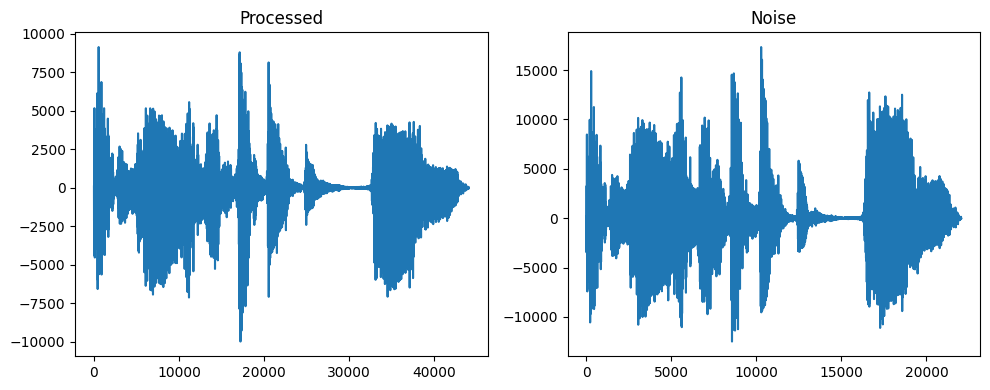

In [643]:
import matplotlib.pyplot as plt
# Create a figure with two subplots side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 4))

# Plot the first set of values in the first subplot
axs[0].plot(processed)
axs[0].set_title('Processed')

# Plot the second set of values in the second subplot
axs[1].plot(original)
axs[1].set_title('Noise')


# Adjust layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()

In [644]:
# excel_file_path = "D:/4th Year/1st Term/IOT/Dr Sofy/Hearing Aid/echo-ha/clean_57.xlsx"

# # Read the Excel file into a pandas DataFrame
# clean = pd.read_excel(excel_file_path)

clean, sample_rate = librosa.load("C:/Users/Misara/OneDrive/Desktop/clean_57_22.wav", sr=22050)


In [645]:
clean

array([-0.04431152, -0.0559082 , -0.0557251 , ..., -0.00061035,
       -0.00061035, -0.00030518], dtype=float32)

In [646]:
clean_signal = (clean).astype(np.int16)

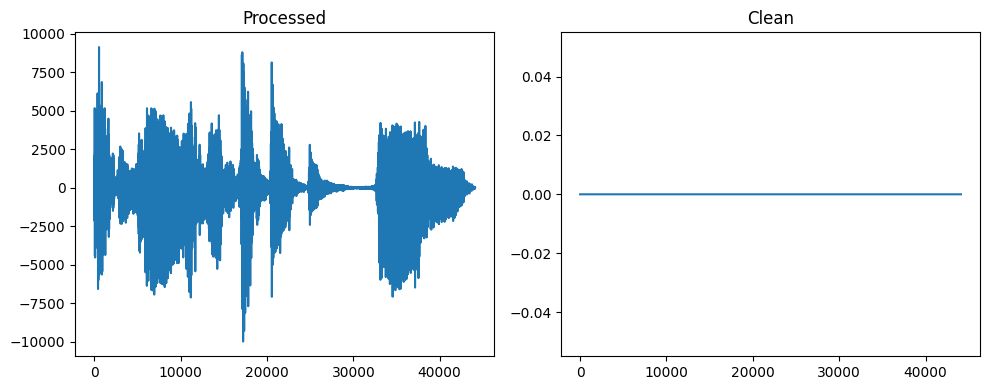

In [647]:
import matplotlib.pyplot as plt
# Create a figure with two subplots side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 4))

# Plot the first set of values in the first subplot
axs[0].plot(processed)
axs[0].set_title('Processed')

# Plot the second set of values in the second subplot
axs[1].plot(clean_signal)
axs[1].set_title('Clean')


# Adjust layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()

In [648]:
clean

array([-0.04431152, -0.0559082 , -0.0557251 , ..., -0.00061035,
       -0.00061035, -0.00030518], dtype=float32)

In [649]:
# clean = clean.values
# clean = clean.flatten()
# clean = clean.T

In [650]:
clean_signal = (clean).astype(np.int16)
from scipy.io.wavfile import write
write("C:/Users/Misara/OneDrive/Desktop/clean_57.wav", 11025, clean_signal)

In [651]:
original = original.values
original = original.flatten()
original = original.T

In [652]:
echo = (original).astype(np.int16)
from scipy.io.wavfile import write
write("C:/Users/Misara/OneDrive/Desktop/echo_57.wav", 11025, echo)